In [25]:
#!pip install plotly

In [26]:
import tensorflow as tf
from tensorflow.keras.models import Sequential,Model
from tensorflow.keras.layers import Dense,Flatten,Conv2D,MaxPooling2D
from tensorflow.keras.layers  import Concatenate
from tensorflow.keras.layers import AveragePooling2D, Dropout, Input, BatchNormalization
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.optimizers import SGD
from sklearn.metrics import classification_report, confusion_matrix
from keras.layers import Input, Add, Dense,GlobalAvgPool2D, Concatenate, AvgPool2D, Dropout, ReLU, Activation, MaxPool2D, ZeroPadding2D, BatchNormalization, Flatten, Conv2D, GlobalAveragePooling2D, AveragePooling2D, MaxPooling2D, GlobalMaxPooling2D
import matplotlib.pyplot as plt # for ploting graph
import os
#-------------------------------------------------------------------------------
from tensorflow.keras.preprocessing.image import load_img, img_to_array, ImageDataGenerator
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import classification_report
from sklearn.preprocessing import LabelBinarizer
#For ROC
from sklearn.metrics import roc_curve 
from sklearn.metrics import auc
from sklearn.metrics import roc_auc_score
from time import perf_counter 
#-------------------------------------------------------------------------------
import plotly.graph_objects as go_obj
from plotly.subplots import make_subplots
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

In [64]:
import os

dataset_root = r"D:\New Plant Diseases Dataset(Augmented)"
train_path = os.path.join(dataset_root, "train")
valid_path = os.path.join(dataset_root, "valid")
test_path  = os.path.join(dataset_root, "test")

diseases = os.listdir(train_path)


In [35]:
batch_size=50 # batch size

In [36]:
#Setting the Traning dataset folder
training_set = ImageDataGenerator( rescale = 1/255.5)
training_data = training_set.flow_from_directory(
    train_path,
    target_size = (224,224),
    class_mode = "categorical",
    batch_size = batch_size
  )

Found 70295 images belonging to 38 classes.


In [37]:
#Setting the validation dataset folder 
validation_set = ImageDataGenerator( rescale = 1/255.5)
validation_data = validation_set.flow_from_directory(
    valid_path,
    target_size = (224,224),
    class_mode = "categorical",
    shuffle = False,  # For corretly printing the ConfusionMartix and Roc curvs
    batch_size = batch_size
)

Found 17572 images belonging to 38 classes.


In [38]:
#Finding the categories
categories = training_data.class_indices.keys()
print(categories)

dict_keys(['Apple___Apple_scab', 'Apple___Black_rot', 'Apple___Cedar_apple_rust', 'Apple___healthy', 'Blueberry___healthy', 'Cherry_(including_sour)___Powdery_mildew', 'Cherry_(including_sour)___healthy', 'Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot', 'Corn_(maize)___Common_rust_', 'Corn_(maize)___Northern_Leaf_Blight', 'Corn_(maize)___healthy', 'Grape___Black_rot', 'Grape___Esca_(Black_Measles)', 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)', 'Grape___healthy', 'Orange___Haunglongbing_(Citrus_greening)', 'Peach___Bacterial_spot', 'Peach___healthy', 'Pepper,_bell___Bacterial_spot', 'Pepper,_bell___healthy', 'Potato___Early_blight', 'Potato___Late_blight', 'Potato___healthy', 'Raspberry___healthy', 'Soybean___healthy', 'Squash___Powdery_mildew', 'Strawberry___Leaf_scorch', 'Strawberry___healthy', 'Tomato___Bacterial_spot', 'Tomato___Early_blight', 'Tomato___Late_blight', 'Tomato___Leaf_Mold', 'Tomato___Septoria_leaf_spot', 'Tomato___Spider_mites Two-spotted_spider_mite', 'Tomato__

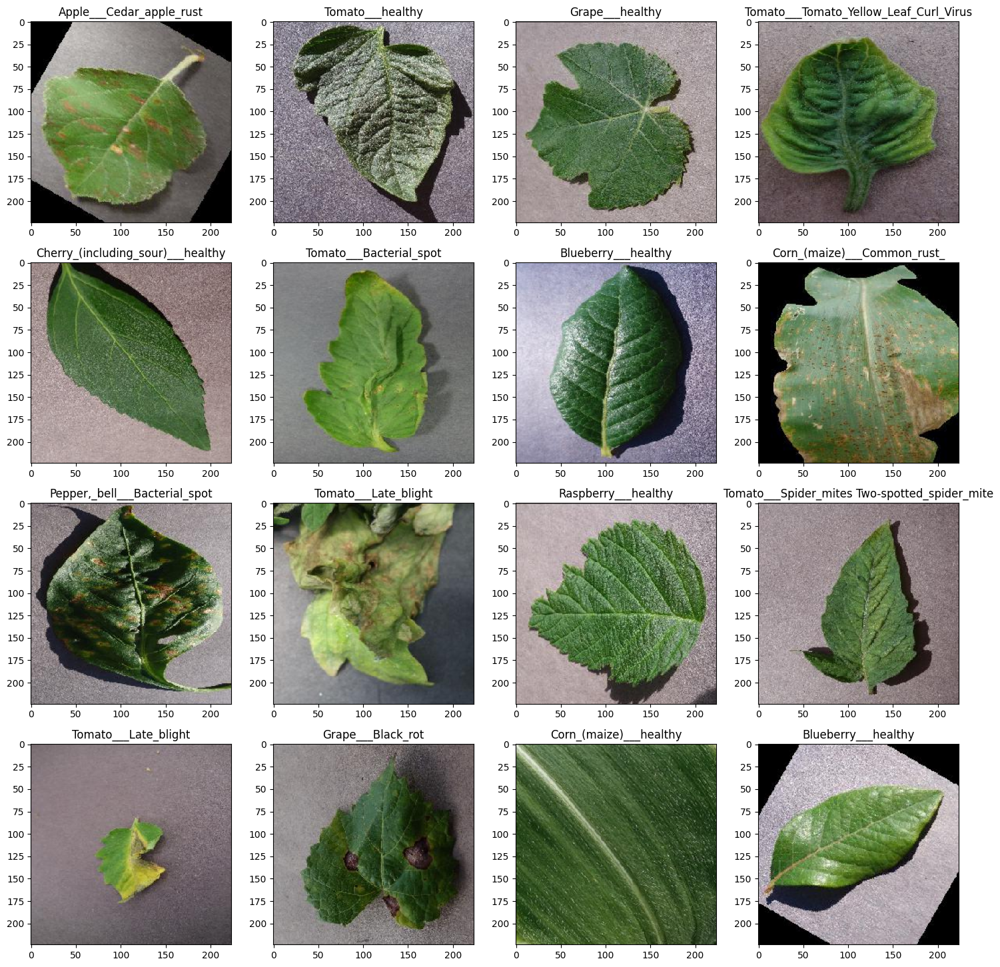

In [39]:
#getting the class name and displaying 16 images and its class name
classes=list(training_data.class_indices.keys())
plt.figure(figsize=(18,18))
for X_batch, y_batch in training_data:
    
    for i in range(0,16):
        plt.subplot(4,4,i+1)
        plt.imshow(X_batch[i])
        plt.title(classes[np.where(y_batch[i]==1)[0][0]])
    # show the plot
    plt.show()
   # plt.savefig('rnd.jpg', bbox_inches = 'tight')
    break

In [40]:
#Finding Number of Uniqe plantes in the dataset
plants = []
NumberOfDiseases = 0
for plant in diseases:
    if plant.split('___')[0] not in plants:
        plants.append(plant.split('___')[0])
    if plant.split('___')[1] != 'healthy':
        NumberOfDiseases += 1
print(f"Unique Plants are: \n{plants}\n")
# displayig number of unique diseases
print("Number of diseases are: {}".format(NumberOfDiseases))

Unique Plants are: 
['Apple', 'Blueberry', 'Cherry_(including_sour)', 'Corn_(maize)', 'Grape', 'Orange', 'Peach', 'Pepper,_bell', 'Potato', 'Raspberry', 'Soybean', 'Squash', 'Strawberry', 'Tomato']

Number of diseases are: 26


In [41]:
# Number of images for each disease
nums_train = {}
nums_val = {}
for disease in diseases:
    nums_train[disease] = len(os.listdir(train_path + '/' + disease))
    nums_val[disease] = len(os.listdir(valid_path + '/' + disease))
img_per_class_train = pd.DataFrame(nums_train.values(), index=nums_train.keys(), columns=["no. of images"])
print('Train datast distribution :')
img_per_class_train

Train datast distribution :


,no. of images
Apple___Apple_scab,2016
Apple___Black_rot,1987
Apple___Cedar_apple_rust,1760
Apple___healthy,2008
Blueberry___healthy,1816
Cherry_(including_sour)___healthy,1826
Cherry_(including_sour)___Powdery_mildew,1683
Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot,1642
Corn_(maize)___Common_rust_,1907
Corn_(maize)___healthy,1859


Text(0.5, 1.0, 'Images per each class of plant disease')

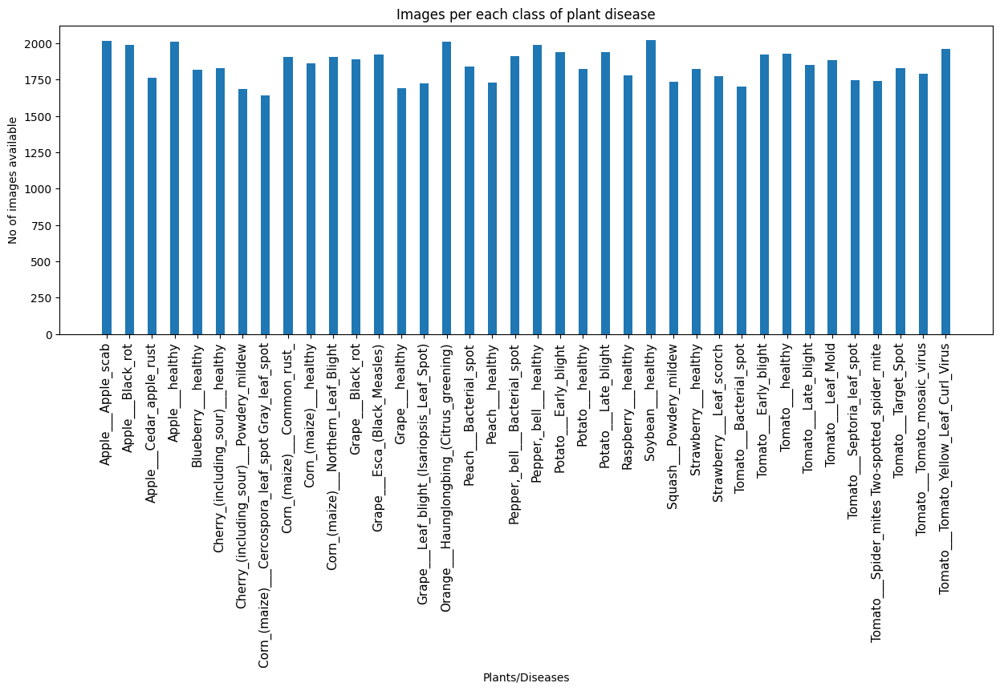

In [42]:
# section for visualising each class in the training raw dataset
train_diratory=train_path
nums = {}
for disease in diseases:
    nums[disease] = len(os.listdir(train_path + '/' + disease))

# plotting number of images available for each image classes
index = [n for n in range(38)]
plt.figure(figsize=(15, 5))
plt.bar(index, [n for n in nums.values()], width=0.4)
plt.xlabel('Plants/Diseases', fontsize=10)
plt.ylabel('No of images available', fontsize=10)
plt.xticks(index, diseases, fontsize=11, rotation=90)
plt.title('Images per each class of plant disease')

In [43]:
#Custom Model here
def define_custom_model():
  custom_model = keras.Sequential()
  custom_model.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)))
  custom_model.add(layers.MaxPooling2D((2, 2)))
  custom_model.add(layers.Conv2D(64, (3, 3), activation='relu'))
  custom_model.add(layers.MaxPooling2D((2, 2)))

  custom_model.add(BatchNormalization()) # Adding  Batch normalizitoan #

  custom_model.add(layers.Conv2D(128, (3, 3), activation='relu'))
  custom_model.add(layers.MaxPooling2D((2, 2)))
  custom_model.add(layers.Conv2D(256, (3, 3), activation='relu'))
  custom_model.add(layers.MaxPooling2D((2, 2)))
  custom_model.add(layers.Conv2D(256, (3, 3), activation='relu'))
  custom_model.add(layers.MaxPooling2D((2, 2)))
  custom_model.add(layers.Conv2D(512, (3, 3), activation='relu'))
  custom_model.add(layers.MaxPooling2D((3, 3)))

  custom_model.add(layers.Flatten())
  custom_model.add(layers.Dropout(0.5))
  custom_model.add(Flatten())
  custom_model.add(Dense(1024,activation='relu'))
  custom_model.add(layers.Dense((38), activation='softmax'))

  return custom_model
################################################################################

In [44]:
###############################################################################
#Setting up differt custome  models  here
model = define_custom_model()  # setting the model -5 
################################################################################

In [45]:
################################################################################
#Model compiling  
opt = keras.optimizers.Adam(learning_rate=0.0001)
model.compile(optimizer=opt,loss='categorical_crossentropy',metrics=['accuracy'])
################################################################################

In [46]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_10 (Conv2D)          (None, 222, 222, 32)      896       
                                                                 
 max_pooling2d_5 (MaxPooling  (None, 111, 111, 32)     0         
 2D)                                                             
                                                                 
 conv2d_11 (Conv2D)          (None, 109, 109, 64)      18496     
                                                                 
 max_pooling2d_6 (MaxPooling  (None, 54, 54, 64)       0         
 2D)                                                             
                                                                 
 batch_normalization (BatchN  (None, 54, 54, 64)       256       
 ormalization)                                                   
                                                      

In [47]:
import keras.callbacks as callbacks
import time
early_stopping_cb = callbacks.EarlyStopping(monitor="loss", patience=3)

In [48]:
start_training = perf_counter() 
history = model.fit(
    training_data, 
    validation_data = validation_data,
    epochs = 12, batch_size = 50,
    callbacks=[early_stopping_cb]
)
end_training= perf_counter() 

Epoch 1/12
1406/1406 [==============================] - 4872s 3s/step - loss: 1.4860 - accuracy: 0.5568 - val_loss: 0.5391 - val_accuracy: 0.8310
Epoch 2/12
1406/1406 [==============================] - 4680s 3s/step - loss: 0.5717 - accuracy: 0.8171 - val_loss: 0.3052 - val_accuracy: 0.9041
Epoch 3/12
1406/1406 [==============================] - 4701s 3s/step - loss: 0.3597 - accuracy: 0.8843 - val_loss: 0.2227 - val_accuracy: 0.9252
Epoch 4/12
1406/1406 [==============================] - 4698s 3s/step - loss: 0.2615 - accuracy: 0.9148 - val_loss: 0.1533 - val_accuracy: 0.9492
Epoch 5/12
1406/1406 [==============================] - 4741s 3s/step - loss: 0.2071 - accuracy: 0.9319 - val_loss: 0.1445 - val_accuracy: 0.9529
Epoch 6/12
1406/1406 [==============================] - 4673s 3s/step - loss: 0.1671 - accuracy: 0.9450 - val_loss: 0.1057 - val_accuracy: 0.9649
Epoch 7/12
1406/1406 [==============================] - 4686s 3s/step - loss: 0.1359 - accuracy: 0.9554 - val_loss: 0.3341 -

In [53]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

train_datagen = ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_directory(
    r'D:\New Plant Diseases Dataset(Augmented)'
,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical'
)


Found 87900 images belonging to 4 classes.


In [55]:
def Display_Model_Loss_Accuracy(history):
  # funtion for ploting model accuracy and loss graph
  #=============================================================================
  # Create figure with secondary y-axis
  fig = make_subplots(specs=[[{"secondary_y": True}]])

  # Adding traces ------------------------------------------------------------
  fig.add_trace(go_obj.Scatter( y=history.history['val_loss'], name="val_loss"),secondary_y=False,)
  fig.add_trace(go_obj.Scatter( y=history.history['loss'], name="loss"),secondary_y=False,)
  fig.add_trace(go_obj.Scatter( y=history.history['val_accuracy'], name="val accuracy"),secondary_y=True,)
  fig.add_trace(go_obj.Scatter( y=history.history['accuracy'], name="accuracy"),secondary_y=True,)

  # Adding figure title---------------------------------------------------------
  fig.update_layout(title_text="Loss/Accuracy of Final Model")
  # Set x-axis title
  fig.update_xaxes(title_text="Epoch")

  # Set y-axes titles-----------------------------------------------------------
  fig.update_yaxes(title_text="<b>primary</b> Loss", secondary_y=False)
  fig.update_yaxes(title_text="<b>secondary</b> Accuracy", secondary_y=True)
  fig.show()
  #============================================================================

In [56]:
Display_Model_Loss_Accuracy(history) # calling funciton to print model accuracy graph

In [57]:
################################################################################
def validate_test_images_and_display(model,number_test_images):
  #funtion for prediting the 33 supplied test image's file name and predicted class
  test_image_data = []
  test_image_filenames = []
  IMG_SHAPE  = (224, 224)
  #-----------------------------------------------------------------------------
  for img_name in os.listdir(test_path):
    img = load_img(os.path.join(test_path, img_name), target_size = IMG_SHAPE)
    test_image_data.append(img_to_array(img, dtype = 'uint8'))
    test_image_filenames.append(img_name)
      
  test_image_data = np.array(test_image_data)/255
  #print(f'\nTotal testing images: {len(test_image_data)}')
  #-----------------------------------------------------------------------------
  test_pred = np.argmax(model.predict(test_image_data), axis = 1)

  class_name_lookup = {name: index for index, name in training_data.class_indices.items()}
  #for k, v in class_name_lookup.items():
  #  print(f"{k:2} : {v}")
  
  test_pred_classes = [class_name_lookup[i] for i in test_pred]

  data_frame=pd.DataFrame({
    "Filename": test_image_filenames,
    "Predicted classes": test_pred_classes
    })
  display (data_frame) # Displaying the dataframe 
  #-----------------------------------------------------------------------------
  #Display test images and its real label and predecited label here
  plt.subplots(nrows = 3, ncols = 4, figsize = (20, 15))

  for i in range(number_test_images):
    plt.subplot(3, 4, i + 1)
    plt.axis(False)
    plt.grid(False)
    plt.imshow(test_image_data[i])
    plt.title(f"True: {test_image_filenames[i][:-4]}\nPrediction:{test_pred_classes[i]}")
  plt.show()
  #-----------------------------------------------------------------------------
################################################################################

2/2 [==============================] - 1s 32ms/step


,Filename,Predicted classes
0,AppleCedarRust1.JPG,Apple___Cedar_apple_rust
1,AppleCedarRust2.JPG,Apple___Cedar_apple_rust
2,AppleCedarRust3.JPG,Apple___Cedar_apple_rust
3,AppleCedarRust4.JPG,Apple___Cedar_apple_rust
4,AppleScab1.JPG,Apple___Apple_scab
5,AppleScab2.JPG,Apple___Apple_scab
6,AppleScab3.JPG,Potato___Early_blight
7,CornCommonRust1.JPG,Corn_(maize)___Common_rust_
8,CornCommonRust2.JPG,Corn_(maize)___Common_rust_
9,CornCommonRust3.JPG,Corn_(maize)___Common_rust_


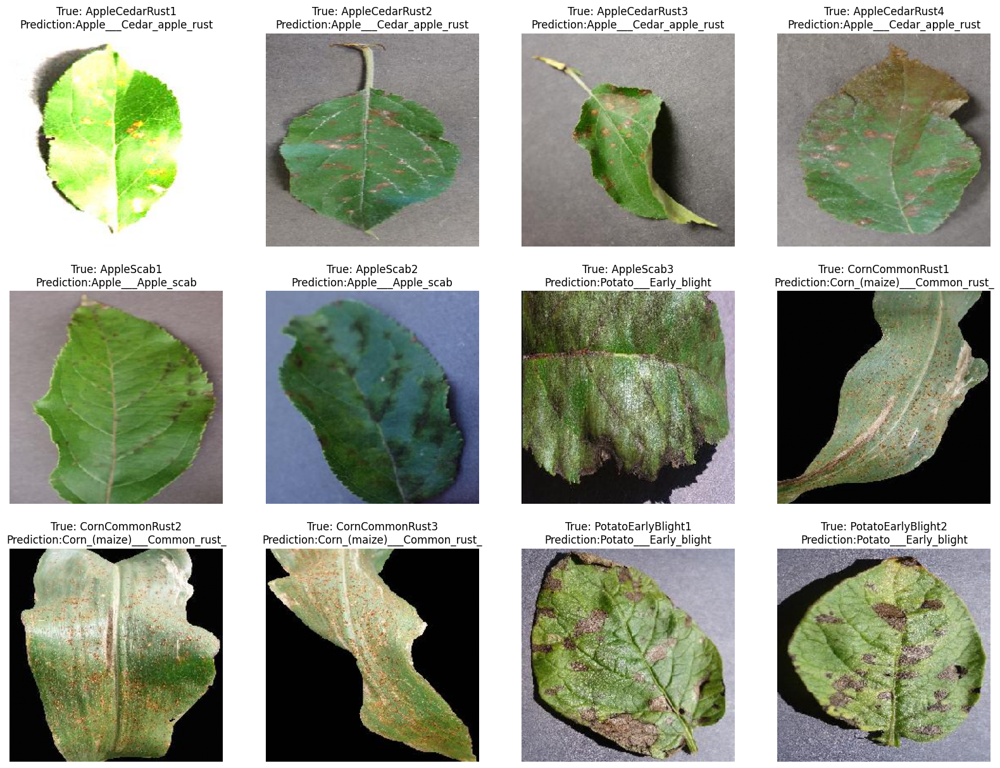

In [65]:
number_test_images=12 # printing 12 images from the supplied test images
validate_test_images_and_display(model,number_test_images) # Prediting the supplied 33 images which is unkonw to the model

In [66]:
class_name_lookup = {name: index for index, name in training_data.class_indices.items()}

In [67]:
#For confusion matrix
val_true = validation_data.classes
val_pred = np.argmax(model.predict(validation_data), axis = 1)
val_pred_float=model.predict(validation_data)
class_name_lookup = {name: index for index, name in training_data.class_indices.items()}

352/352 [==============================] - 278s 789ms/step


In [68]:
################################################################################
#Fuction to dispay confusion matrix based on the predections.
def Display_Confusion_Matrix(val_true,val_pred,class_name_lookup):
  # here printing the confustion matrix
  _, ax = plt.subplots(figsize = (20, 16))
  ax.grid(False)

  ConfusionMatrixDisplay(confusion_matrix(val_true, val_pred, labels = list(class_name_lookup.keys())),
                        display_labels = list(class_name_lookup.values())
                        ).plot(ax = ax, xticks_rotation = 'vertical')

  plt.savefig('confusion_matrix.jpg', bbox_inches = 'tight')
  plt.show()
################################################################################

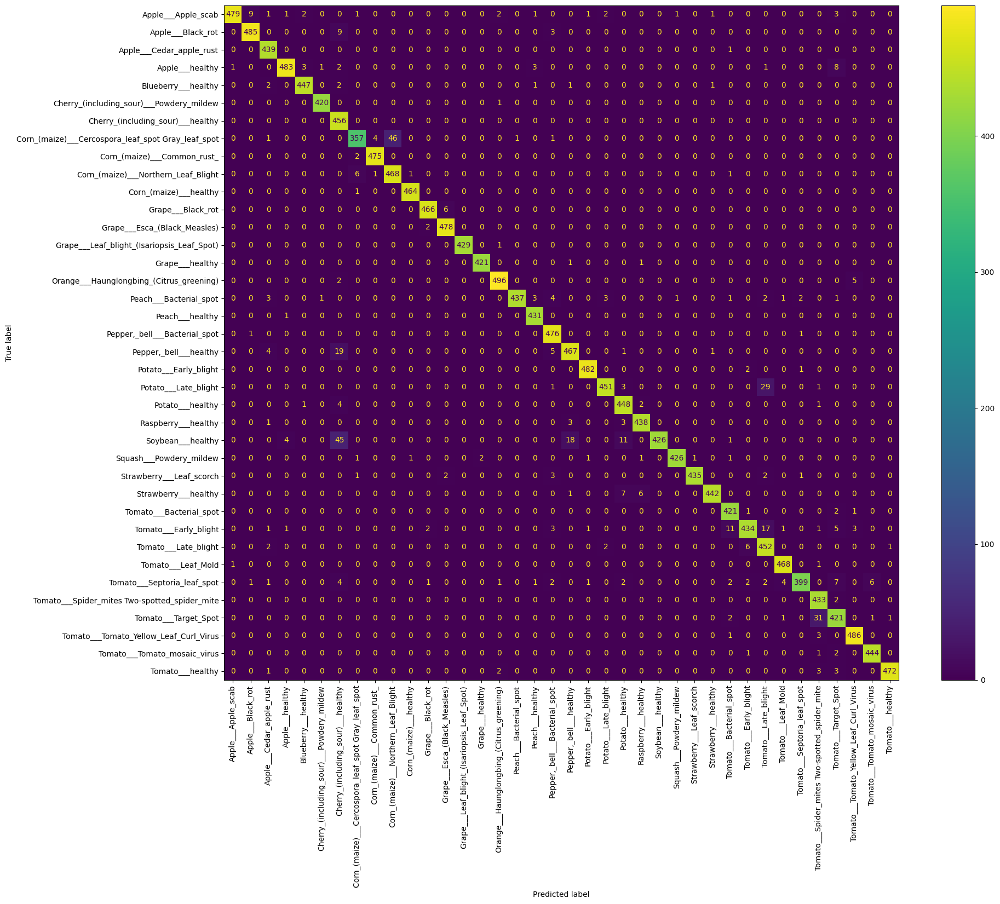

In [69]:
Display_Confusion_Matrix(val_true,val_pred,class_name_lookup) # confusion-matrix

In [70]:
def Dispay_Classifiation_Report(val_true,val_pred,class_name_lookup):
################################################################################
# classifiation report printing here
  display_labels = list(class_name_lookup.values())
  print(classification_report(val_true,val_pred,target_names=class_name_lookup.values())) 
################################################################################

In [71]:
Dispay_Classifiation_Report(val_true,val_pred,class_name_lookup)

                                                    precision    recall  f1-score   support

                                Apple___Apple_scab       1.00      0.95      0.97       504
                                 Apple___Black_rot       0.98      0.98      0.98       497
                          Apple___Cedar_apple_rust       0.96      1.00      0.98       440
                                   Apple___healthy       0.99      0.96      0.97       502
                               Blueberry___healthy       0.99      0.98      0.99       454
          Cherry_(including_sour)___Powdery_mildew       1.00      1.00      1.00       421
                 Cherry_(including_sour)___healthy       0.84      1.00      0.91       456
Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot       0.97      0.87      0.92       410
                       Corn_(maize)___Common_rust_       0.99      1.00      0.99       477
               Corn_(maize)___Northern_Leaf_Blight       0.91      0.98      0.

In [72]:
target=validation_data.class_indices.keys() # getting the classs names for printing the ROC Graph
y_test =  validation_data.classes

In [73]:
################################################################################
# function  roc auc score for multi-class datasets, since this dataset has 38 class
# funtion calling 2 times
def Multiclass_Roc_Auc_Scores(y_test, y_pred,min_class,max_class, average="macro"):
    lb = LabelBinarizer()
    lb.fit(y_test)
    y_test = lb.transform(y_test)
    y_pred = lb.transform(y_pred)
    i=0
    for (idx, c_label) in enumerate(target):
          i=i+1
          fpr, tpr, thresholds = roc_curve(y_test[:,idx].astype(int), y_pred[:,idx])
          if i>=min_class and i<=max_class: 
            c_ax.plot(fpr, tpr, label = '%s (AUC:%0.2f)'  % (c_label, auc(fpr, tpr)))
    c_ax.plot(fpr, fpr, 'b-', label = 'Random Guessing')
    return roc_auc_score(y_test, y_pred, average=average)

ROC AUC score: 0.9849753677700507


Text(0, 0.5, 'True Positive Rate')

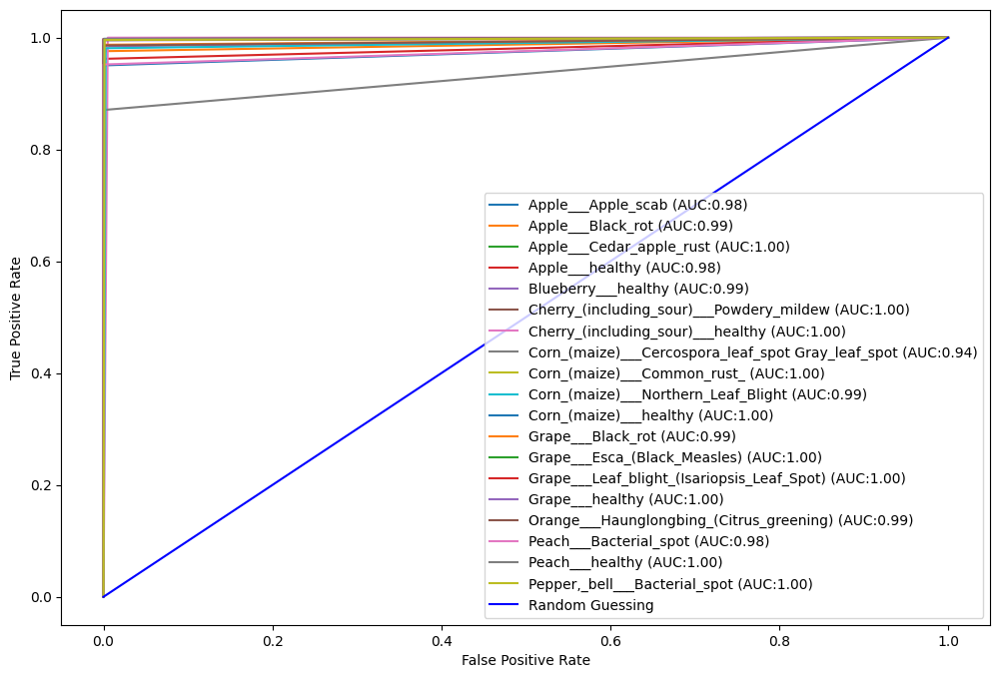

In [74]:
################################################################################
#Printing ROC curve for the class 1-19 here
fig, c_ax = plt.subplots(1,1, figsize = (12, 8))
print('ROC AUC score:', Multiclass_Roc_Auc_Scores(y_test, val_pred,1,19))
c_ax.legend()
c_ax.set_xlabel('False Positive Rate')
c_ax.set_ylabel('True Positive Rate')

In [75]:
model.save('final_model.h5') # saving the Model here, so that re-use the model later 

In [76]:
def model_evalution(ev_model,value_data,model_size):
    ################################################################################
    #Model evalution : # Getting  validation accuracy and model size time to train
    ################################################################################
    start = perf_counter() 
    loss,Model_Accuracy = ev_model.evaluate(value_data, verbose = 0 )
    end = perf_counter() 
    ModelSize = model_size
    # let convert to MB
    ModelSize = ModelSize / (1024 * 1024)
    #-------------------------------------------------------------------------------
    print('Model Summary:')
    print('Model size(MB)                : {}'.format(ModelSize))
    print('Time on Validation data (sec) : {}'.format(end - start))
    print('Accuracy on validation data   : {}'.format(Model_Accuracy))
    print('Loss on validation data       : {}'.format(loss))
    #print('Time on Training Model  (sec) : {}'.format(end_training - start_training)

In [78]:
model_evalution(model,validation_data,os.path.getsize('final_model.h5'))

Model Summary:
Model size(MB)                : 31.251678466796875
Time on Validation data (sec) : 708.066739599999
Accuracy on validation data   : 0.9704074859619141
Loss on validation data       : 0.09087592363357544


In [79]:
## *** InceptionV3 **###
#Import the InceptionV3 library as shown below and
#add preprocessing layer to the front of InceptionV3
from tensorflow.keras.applications.inception_v3 import InceptionV3
#-------------------------------------------------------------------------------
inception = InceptionV3(input_shape=(224,224,3), weights='imagenet', include_top=False)
print("*** Building model with InceptionV3 with imagenet weights***")
model_inception = Sequential([
    inception,
    Flatten(),
    Dense(512, activation='relu'),
    Dropout(rate=0.2),
    Dense(38, activation='softmax')
])

87910968/87910968 [==============================] - 25s 0us/step
*** Building model with InceptionV3 with imagenet weights***


In [80]:
######################################################################################
#Setting the same model name here, so all the functions will work without out any chage
model = model_inception #setting Inception model here
######################################################################################

In [81]:
################################################################################
#Model compiling
opt = keras.optimizers.Adam(learning_rate=0.0001)
model.compile(optimizer=opt,loss='categorical_crossentropy',metrics=['accuracy'])
################################################################################

In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import matplotlib.pyplot as plt

In [84]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import matplotlib.pyplot as plt

In [88]:
model = tf.keras.models.load_model('final_model.h5')


In [89]:
!pip install opencv-python

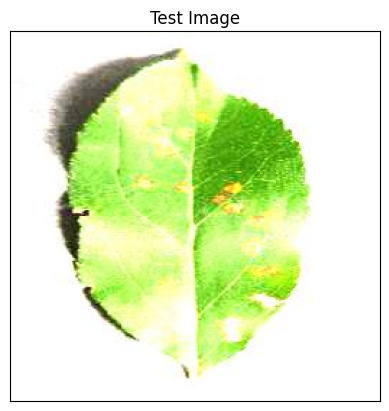

In [91]:
import cv2
image_path="test/AppleCedarRust1.JPG"
#reading image
img=cv2.imread(image_path)
img=cv2.cvtColor(img,cv2.COLOR_BGR2RGB) #convert bgr image to rgb
#displaying image
plt.imshow(img)
plt.title("Test Image")
plt.xticks([])
plt.yticks([])
plt.show()

In [92]:
image=tf.keras.preprocessing.image.load_img(image_path,target_size=(128,128))
input_arr=tf.keras.preprocessing.image.img_to_array(image)
input_arr=np.array([input_arr]) #convert single image to a batch
print(input_arr.shape)

(1, 128, 128, 3)


In [100]:
img_path = r"test/AppleCedarRust1.JPG"
img = load_img(img_path, target_size=(224, 224))
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import numpy as np

# Example for a single image
img = load_img(r"test/AppleCedarRust1.JPG", target_size=(224, 224))
img_array = img_to_array(img)
img_array = img_array / 255.0  # Optional: normalize if model was trained that way
input_arr = np.expand_dims(img_array, axis=0)  # Model expects shape: (1, 224, 224, 3)

predictions = model.predict(input_arr)



1/1 [==============================] - 0s 382ms/step


In [101]:
result_index=np.argmax(predictions)
result_index

2

In [102]:
image=tf.keras.preprocessing.image.load_img(image_path,target_size=(128,128))
input_arr=tf.keras.preprocessing.image.img_to_array(image)
input_arr=np.array([input_arr]) #convert single image to a batch

In [103]:
predictions=model.predict(input_arr)
predictions,predictions.shape

1/1 [==============================] - 0s 348ms/step


(array([], shape=(0, 38), dtype=float32), (0, 38))

In [106]:
print("Predictions:", predictions)
print("Shape:", predictions.shape)


Predictions: []
Shape: (0, 38)


In [107]:
print("Input shape:", input_arr.shape)


Input shape: (1, 128, 128, 3)


In [109]:
import os
print(os.getcwd())  # Shows your current working directory


D:\New Plant Diseases Dataset(Augmented)


In [111]:
model_path = r"final_model.h5"
model = tf.keras.models.load_model(model_path)


In [113]:
class_name=['Apple___Apple_scab',
 'Apple___Black_rot',
 'Apple___Cedar_apple_rust',
 'Apple___healthy',
 'Blueberry___healthy',
 'Cherry_(including_sour)_Powdery_mildew',
 'Cherry_(including_sour)_healthy',
 'Corn_(maize)_Cercospora_leaf_spot Gray_leaf_spot',
 'Corn_(maize)Common_rust',
 'Corn_(maize)_Northern_Leaf_Blight',
 'Corn_(maize)_healthy',
 'Grape___Black_rot',
 'Grape__Esca(Black_Measles)',
 'Grape__Leaf_blight(Isariopsis_Leaf_Spot)',
 'Grape___healthy',
 'Orange__Haunglongbing(Citrus_greening)',
 'Peach___Bacterial_spot',
 'Peach___healthy',
 'Pepper,bell__Bacterial_spot',
 'Pepper,bell__healthy',
 'Potato___Early_blight',
 'Potato___Late_blight',
 'Potato___healthy',
 'Raspberry___healthy',
 'Soybean___healthy',
 'Squash___Powdery_mildew',
 'Strawberry___Leaf_scorch',
 'Strawberry___healthy',
 'Tomato___Bacterial_spot',
 'Tomato___Early_blight',
 'Tomato___Late_blight',
 'Tomato___Leaf_Mold',
 'Tomato___Septoria_leaf_spot',
 'Tomato___Spider_mites Two-spotted_spider_mite',
 'Tomato___Target_Spot',
 'Tomato___Tomato_Yellow_Leaf_Curl_Virus',
 'Tomato___Tomato_mosaic_virus',
 'Tomato___healthy']

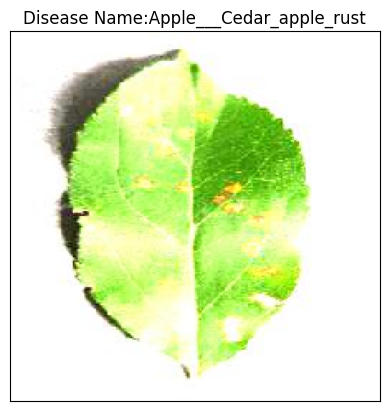

In [114]:
#displaying result of disease prediction
model_prediction=class_name[result_index]
plt.imshow(img)
plt.title(f"Disease Name:{model_prediction}")
plt.xticks([])
plt.yticks([])
plt.show()

In [115]:
model_prediction

'Apple___Cedar_apple_rust'

In [117]:
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing.image import load_img, img_to_array

# --- Load the model ---
model_path = r"final_model.h5"  # Update this
model = tf.keras.models.load_model(model_path)

# --- Define the test folder path ---
test_root = r"D:\New Plant Diseases Dataset(Augmented)\test"  # Update this

# --- Get class names from training folder if available ---
train_path = r"D:\New Plant Diseases Dataset(Augmented)\train"  # Optional: used to infer class names
class_names = sorted(os.listdir(train_path))

# --- Loop through test images and predict ---
for class_dir in os.listdir(test_root):
    class_path = os.path.join(test_root, class_dir)
    
    if not os.path.isdir(class_path):
        continue  # skip files

    print(f"\n--- Testing images from class: {class_dir} ---")

    for img_name in os.listdir(class_path):
        img_path = os.path.join(class_path, img_name)
        
        try:
            # Load and preprocess image
            img = load_img(img_path, target_size=(224, 224))
            img_array = img_to_array(img) / 255.0
            input_arr = np.expand_dims(img_array, axis=0)  # (1, 224, 224, 3)

            # Predict
            predictions = model.predict(input_arr)
            predicted_index = np.argmax(predictions[0])
            predicted_class = class_names[predicted_index]

            print(f"Image: {img_name} | Predicted: {predicted_class} | Actual: {class_dir}")

        except Exception as e:
            print(f"Error processing {img_name}: {e}")


In [119]:
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing.image import load_img, img_to_array

# --- Step 1: Load the model ---
model_path = r"final_model.h5"   # ✅ UPDATE THIS PATH
if not os.path.exists(model_path):
    raise FileNotFoundError(f"Model not found at: {model_path}")
model = tf.keras.models.load_model(model_path)
print("Model loaded successfully.")

# --- Step 2: Set paths ---
test_root = r"D:\New Plant Diseases Dataset(Augmented)\test"  # ✅ UPDATE THIS PATH
if not os.path.exists(test_root):
    raise FileNotFoundError(f"Test folder not found at: {test_root}")

train_path = r"D:\New Plant Diseases Dataset(Augmented)\train"  # Used to get class names
class_names = sorted(os.listdir(train_path))
print(f"Detected classes: {class_names}")

# --- Step 3: Loop and predict ---
for class_dir in os.listdir(test_root):
    class_path = os.path.join(test_root, class_dir)

    if not os.path.isdir(class_path):
        continue

    print(f"\n📁 Class: {class_dir}")

    for img_name in os.listdir(class_path):
        img_path = os.path.join(class_path, img_name)

        try:
            # Load and preprocess image
            img = load_img(img_path, target_size=(224, 224))
            img_array = img_to_array(img) / 255.0
            input_arr = np.expand_dims(img_array, axis=0)

            # Predict
            predictions = model.predict(input_arr, verbose=0)
            predicted_index = np.argmax(predictions[0])
            predicted_class = class_names[predicted_index]

            print(f"🖼️ {img_name} ➜ Predicted: {predicted_class} | Actual: {class_dir}")

        except Exception as e:
            print(f"❌ Error with {img_name}: {e}")


Model loaded successfully.
Detected classes: ['Apple___Apple_scab', 'Apple___Black_rot', 'Apple___Cedar_apple_rust', 'Apple___healthy', 'Blueberry___healthy', 'Cherry_(including_sour)___Powdery_mildew', 'Cherry_(including_sour)___healthy', 'Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot', 'Corn_(maize)___Common_rust_', 'Corn_(maize)___Northern_Leaf_Blight', 'Corn_(maize)___healthy', 'Grape___Black_rot', 'Grape___Esca_(Black_Measles)', 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)', 'Grape___healthy', 'Orange___Haunglongbing_(Citrus_greening)', 'Peach___Bacterial_spot', 'Peach___healthy', 'Pepper,_bell___Bacterial_spot', 'Pepper,_bell___healthy', 'Potato___Early_blight', 'Potato___Late_blight', 'Potato___healthy', 'Raspberry___healthy', 'Soybean___healthy', 'Squash___Powdery_mildew', 'Strawberry___Leaf_scorch', 'Strawberry___healthy', 'Tomato___Bacterial_spot', 'Tomato___Early_blight', 'Tomato___Late_blight', 'Tomato___Leaf_Mold', 'Tomato___Septoria_leaf_spot', 'Tomato___Spider_mites 

In [120]:
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing.image import load_img, img_to_array

# --- Load model ---
model_path =  r"final_model.h5"   # ✅ Set correct path
model = tf.keras.models.load_model(model_path)

# --- Dataset paths ---
test_root = r"D:\New Plant Diseases Dataset(Augmented)\test"  # ✅ Test images path
train_path = r"D:\New Plant Diseases Dataset(Augmented)\train"  # To get class names

# --- Load class names from train directory (sorted for consistency) ---
class_names = sorted(os.listdir(train_path))

# --- Loop through each image in test directory ---
for class_dir in os.listdir(test_root):
    class_path = os.path.join(test_root, class_dir)
    if not os.path.isdir(class_path):
        continue

    print(f"\n🔍 Testing class: {class_dir}")

    for img_name in os.listdir(class_path):
        img_path = os.path.join(class_path, img_name)

        try:
            # Load and preprocess image
            img = load_img(img_path, target_size=(224, 224))
            img_array = img_to_array(img) / 255.0
            input_arr = np.expand_dims(img_array, axis=0)

            # Predict
            predictions = model.predict(input_arr, verbose=0)
            predicted_index = np.argmax(predictions[0])
            predicted_class = class_names[predicted_index]
            confidence = predictions[0][predicted_index]

            # Print result
            print(f"🖼️ {img_name}")
            print(f"   ✅ Predicted: {predicted_class} ({confidence*100:.2f}% confidence)")
            print(f"   🎯 Actual:    {class_dir}\n")

        except Exception as e:
            print(f"❌ Could not process {img_name}: {e}")


In [122]:
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing.image import load_img, img_to_array

# --- Load model ---
model_path = r"final_model.h5"  # ✅ Change this to actual path
print("📦 Loading model...")
model = tf.keras.models.load_model(model_path)
print("✅ Model loaded.")

# --- Dataset paths ---
test_root = r"D:\New Plant Diseases Dataset(Augmented)\test"  # ✅ Change if needed
train_path = r"D:\New Plant Diseases Dataset(Augmented)\train"

# --- Load class names ---
class_names = sorted(os.listdir(train_path))
print(f"🔍 Found {len(class_names)} classes.")

# --- Loop through test images ---
found_any = False
for class_dir in os.listdir(test_root):
    class_path = os.path.join(test_root, class_dir)
    if not os.path.isdir(class_path):
        continue

    print(f"\n🧪 Testing class: {class_dir}")

    for img_name in os.listdir(class_path):
        img_path = os.path.join(class_path, img_name)

        try:
            img = load_img(img_path, target_size=(224, 224))
            img_array = img_to_array(img) / 255.0
            input_arr = np.expand_dims(img_array, axis=0)

            predictions = model.predict(input_arr, verbose=0)
            predicted_index = np.argmax(predictions[0])
            predicted_class = class_names[predicted_index]
            confidence = predictions[0][predicted_index]

            print(f"🖼️ {img_name}")
            print(f"   ✅ Predicted: {predicted_class} ({confidence*100:.2f}% confidence)")
            print(f"   🎯 Actual:    {class_dir}\n")
            found_any = True

        except Exception as e:
            print(f"❌ Error with {img_name}: {e}")

if not found_any:
    print("\n⚠️ No images found. Please check your test folder paths and contents.")


📦 Loading model...
✅ Model loaded.
🔍 Found 38 classes.

⚠️ No images found. Please check your test folder paths and contents.


In [123]:
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing.image import load_img, img_to_array

# Load the trained model
model_path = 'final_model.h5'
model = tf.keras.models.load_model(model_path)

# Set the directory of test images
test_images_path = r'D:\New Plant Diseases Dataset(Augmented)\test'  # Directory where your test images are stored

# List all image files in the test directory
image_files = os.listdir(test_images_path)

# List of classes from your model (replace with your actual classes)
classes = [
    'Apple___Apple_scab', 'Apple___Black_rot', 'Apple___Cedar_apple_rust', 'Apple___healthy',
    'Blueberry___healthy', 'Cherry_(including_sour)___Powdery_mildew', 'Cherry_(including_sour)___healthy',
    'Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot', 'Corn_(maize)___Common_rust_',
    'Corn_(maize)___Northern_Leaf_Blight', 'Corn_(maize)___healthy', 'Grape___Black_rot',
    'Grape___Esca_(Black_Measles)', 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)', 'Grape___healthy',
    'Orange___Haunglongbing_(Citrus_greening)', 'Peach___Bacterial_spot', 'Peach___healthy',
    'Pepper,_bell___Bacterial_spot', 'Pepper,_bell___healthy', 'Potato___Early_blight', 'Potato___Late_blight',
    'Potato___healthy', 'Raspberry___healthy', 'Soybean___healthy', 'Squash___Powdery_mildew',
    'Strawberry___Leaf_scorch', 'Strawberry___healthy', 'Tomato___Bacterial_spot', 'Tomato___Early_blight',
    'Tomato___Late_blight', 'Tomato___Leaf_Mold', 'Tomato___Septoria_leaf_spot', 'Tomato___Spider_mites Two-spotted_spider_mite',
    'Tomato___Target_Spot', 'Tomato___Tomato_Yellow_Leaf_Curl_Virus', 'Tomato___Tomato_mosaic_virus', 'Tomato___healthy'
]

# Loop through each image in the test directory
for img_file in image_files:
    img_path = os.path.join(test_images_path, img_file)
    
    # Load the image and preprocess it
    img = load_img(img_path, target_size=(224, 224))
    img_array = img_to_array(img) / 255.0  # Normalize the image (if your model was trained this way)
    img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension
    
    # Predict the class
    predictions = model.predict(img_array)
    predicted_class_index = np.argmax(predictions, axis=1)
    predicted_class = classes[predicted_class_index[0]]
    confidence = predictions[0][predicted_class_index[0]]
    
    # Print the prediction result and confidence
    print(f"Image: {img_file}")
    print(f"Predicted Class: {predicted_class}")
    print(f"Confidence: {confidence:.4f}")
    print('-' * 50)


1/1 [==============================] - 0s 432ms/step
Image: AppleCedarRust1.JPG
Predicted Class: Apple___Cedar_apple_rust
Confidence: 1.0000
--------------------------------------------------
1/1 [==============================] - 0s 150ms/step
Image: AppleCedarRust2.JPG
Predicted Class: Apple___Cedar_apple_rust
Confidence: 1.0000
--------------------------------------------------
1/1 [==============================] - 0s 153ms/step
Image: AppleCedarRust3.JPG
Predicted Class: Apple___Cedar_apple_rust
Confidence: 1.0000
--------------------------------------------------
1/1 [==============================] - 0s 118ms/step
Image: AppleCedarRust4.JPG
Predicted Class: Apple___Cedar_apple_rust
Confidence: 1.0000
--------------------------------------------------
1/1 [==============================] - 0s 113ms/step
Image: AppleScab1.JPG
Predicted Class: Apple___Apple_scab
Confidence: 0.8564
--------------------------------------------------
1/1 [==============================] - 0s 106ms/ste

1/1 [==============================] - 0s 498ms/step


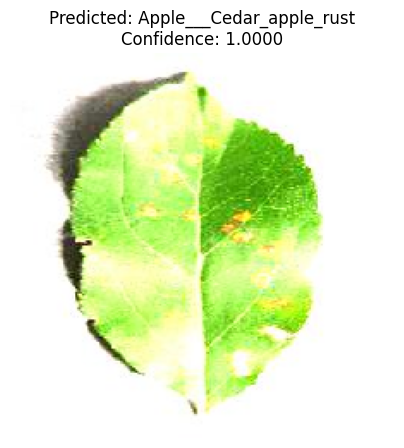

Image: AppleCedarRust1.JPG
Predicted Class: Apple___Cedar_apple_rust
Confidence: 1.0000
--------------------------------------------------
1/1 [==============================] - 0s 139ms/step


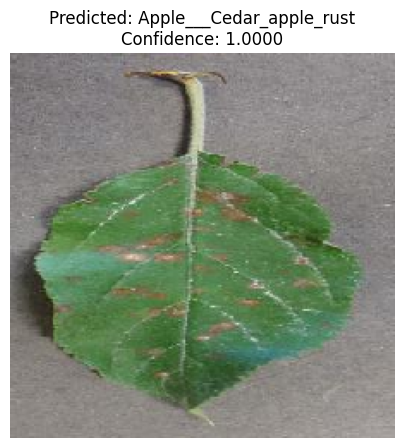

Image: AppleCedarRust2.JPG
Predicted Class: Apple___Cedar_apple_rust
Confidence: 1.0000
--------------------------------------------------
1/1 [==============================] - 0s 131ms/step


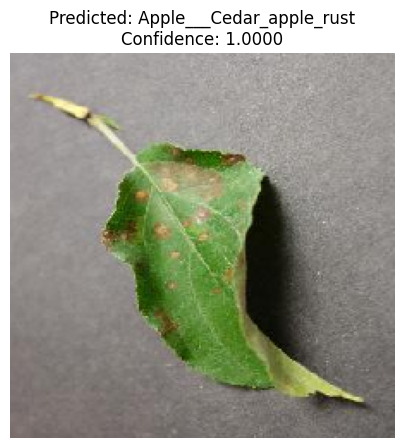

Image: AppleCedarRust3.JPG
Predicted Class: Apple___Cedar_apple_rust
Confidence: 1.0000
--------------------------------------------------
1/1 [==============================] - 0s 102ms/step


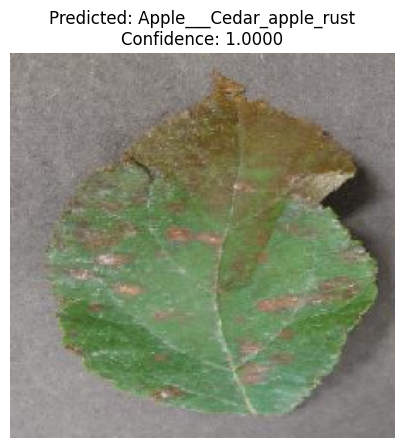

Image: AppleCedarRust4.JPG
Predicted Class: Apple___Cedar_apple_rust
Confidence: 1.0000
--------------------------------------------------
1/1 [==============================] - 0s 101ms/step


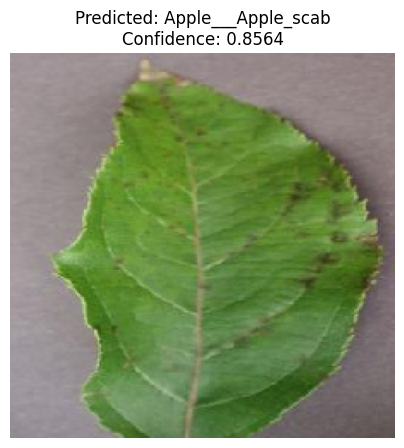

Image: AppleScab1.JPG
Predicted Class: Apple___Apple_scab
Confidence: 0.8564
--------------------------------------------------
1/1 [==============================] - 0s 104ms/step


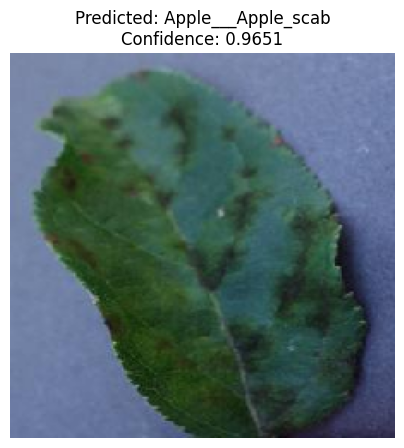

Image: AppleScab2.JPG
Predicted Class: Apple___Apple_scab
Confidence: 0.9651
--------------------------------------------------
1/1 [==============================] - 0s 111ms/step


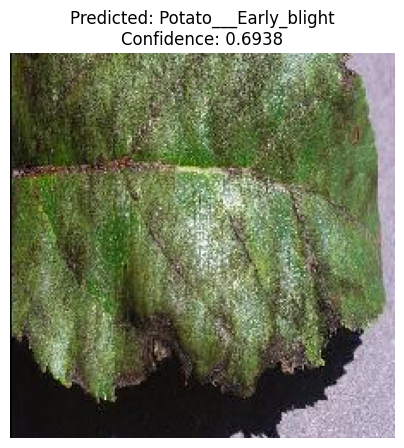

Image: AppleScab3.JPG
Predicted Class: Potato___Early_blight
Confidence: 0.6938
--------------------------------------------------
1/1 [==============================] - 0s 152ms/step


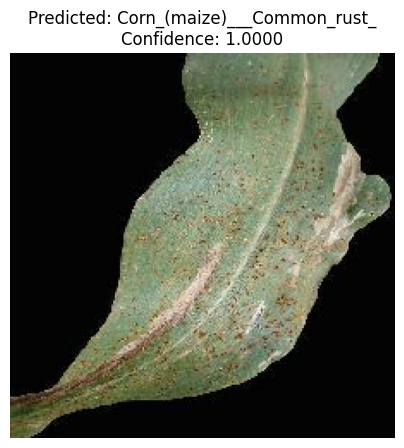

Image: CornCommonRust1.JPG
Predicted Class: Corn_(maize)___Common_rust_
Confidence: 1.0000
--------------------------------------------------
1/1 [==============================] - 0s 140ms/step


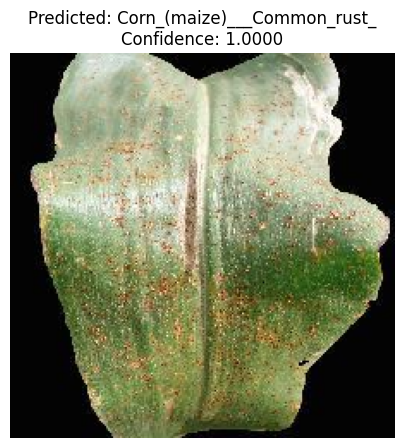

Image: CornCommonRust2.JPG
Predicted Class: Corn_(maize)___Common_rust_
Confidence: 1.0000
--------------------------------------------------
1/1 [==============================] - 0s 171ms/step


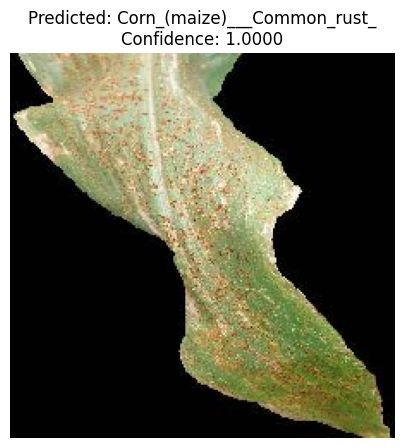

Image: CornCommonRust3.JPG
Predicted Class: Corn_(maize)___Common_rust_
Confidence: 1.0000
--------------------------------------------------
1/1 [==============================] - 0s 139ms/step


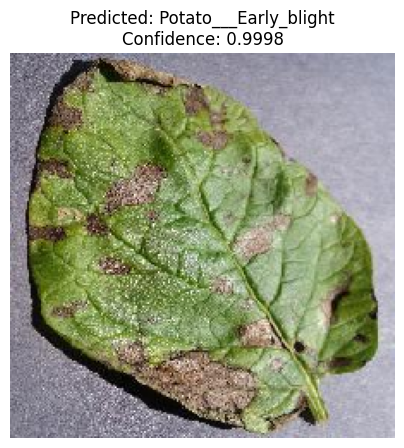

Image: PotatoEarlyBlight1.JPG
Predicted Class: Potato___Early_blight
Confidence: 0.9998
--------------------------------------------------
1/1 [==============================] - 0s 282ms/step


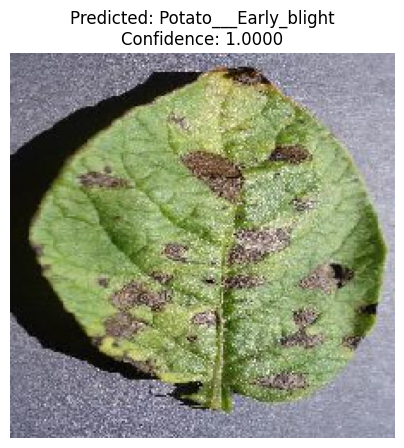

Image: PotatoEarlyBlight2.JPG
Predicted Class: Potato___Early_blight
Confidence: 1.0000
--------------------------------------------------
1/1 [==============================] - 0s 116ms/step


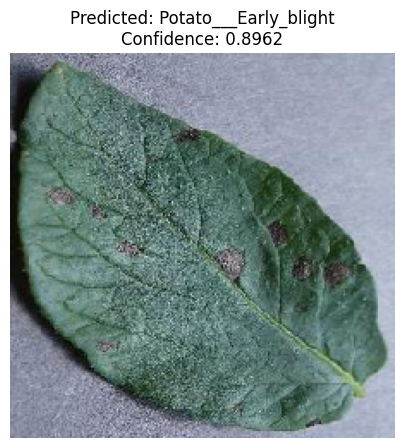

Image: PotatoEarlyBlight3.JPG
Predicted Class: Potato___Early_blight
Confidence: 0.8962
--------------------------------------------------
1/1 [==============================] - 0s 118ms/step


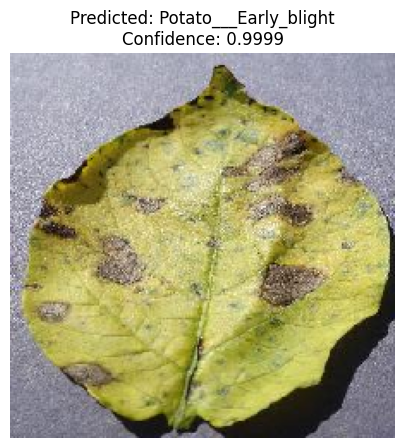

Image: PotatoEarlyBlight4.JPG
Predicted Class: Potato___Early_blight
Confidence: 0.9999
--------------------------------------------------
1/1 [==============================] - 0s 123ms/step


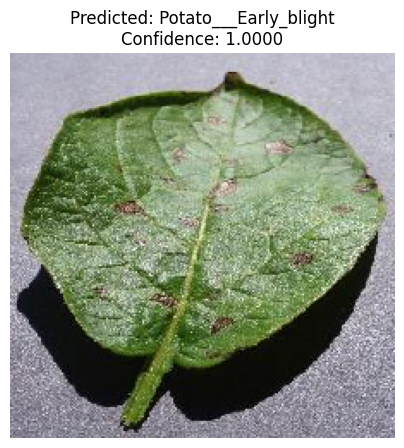

Image: PotatoEarlyBlight5.JPG
Predicted Class: Potato___Early_blight
Confidence: 1.0000
--------------------------------------------------
1/1 [==============================] - 0s 202ms/step


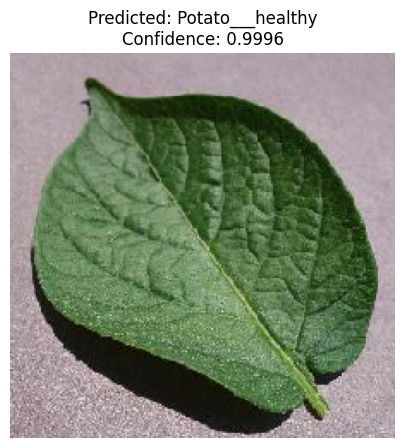

Image: PotatoHealthy1.JPG
Predicted Class: Potato___healthy
Confidence: 0.9996
--------------------------------------------------
1/1 [==============================] - 0s 108ms/step


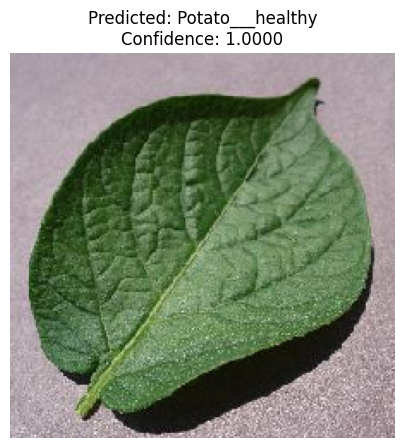

Image: PotatoHealthy2.JPG
Predicted Class: Potato___healthy
Confidence: 1.0000
--------------------------------------------------
1/1 [==============================] - 0s 115ms/step


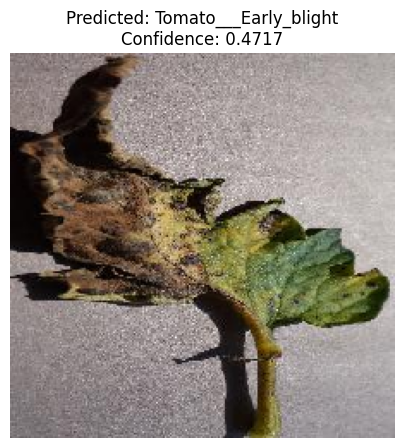

Image: TomatoEarlyBlight1.JPG
Predicted Class: Tomato___Early_blight
Confidence: 0.4717
--------------------------------------------------
1/1 [==============================] - 0s 120ms/step


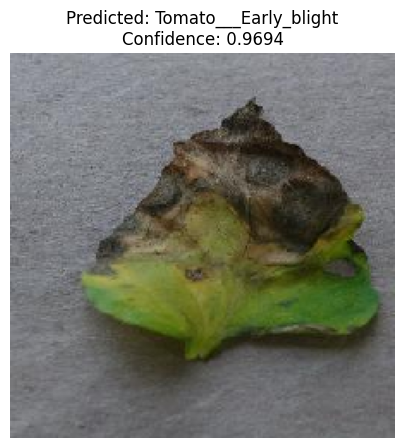

Image: TomatoEarlyBlight2.JPG
Predicted Class: Tomato___Early_blight
Confidence: 0.9694
--------------------------------------------------
1/1 [==============================] - 0s 102ms/step


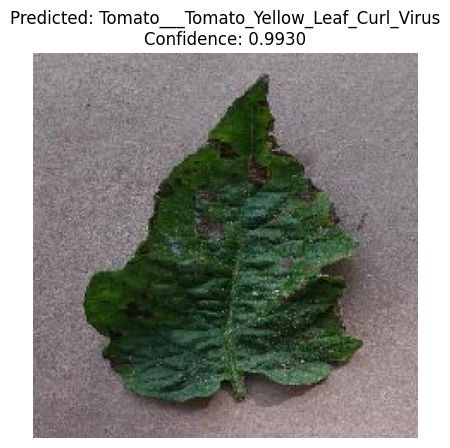

Image: TomatoEarlyBlight3.JPG
Predicted Class: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Confidence: 0.9930
--------------------------------------------------
1/1 [==============================] - 0s 110ms/step


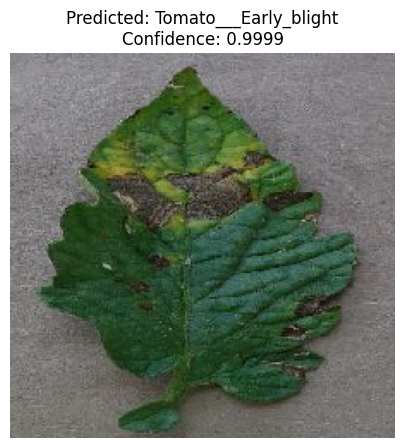

Image: TomatoEarlyBlight4.JPG
Predicted Class: Tomato___Early_blight
Confidence: 0.9999
--------------------------------------------------
1/1 [==============================] - 0s 130ms/step


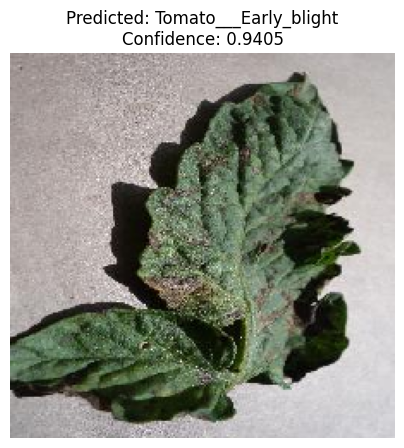

Image: TomatoEarlyBlight5.JPG
Predicted Class: Tomato___Early_blight
Confidence: 0.9405
--------------------------------------------------
1/1 [==============================] - 0s 154ms/step


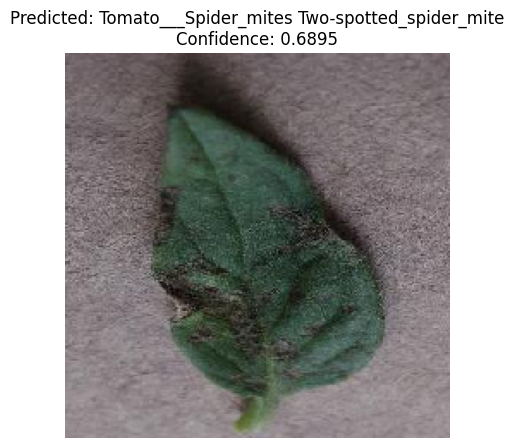

Image: TomatoEarlyBlight6.JPG
Predicted Class: Tomato___Spider_mites Two-spotted_spider_mite
Confidence: 0.6895
--------------------------------------------------
1/1 [==============================] - 0s 137ms/step


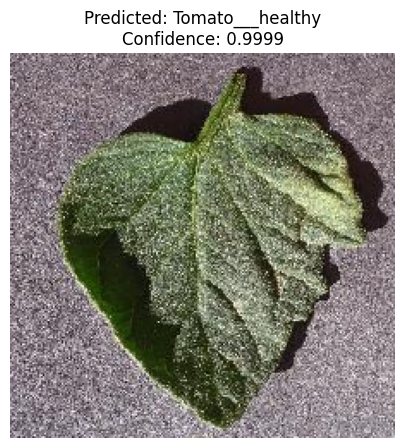

Image: TomatoHealthy1.JPG
Predicted Class: Tomato___healthy
Confidence: 0.9999
--------------------------------------------------
1/1 [==============================] - 0s 108ms/step


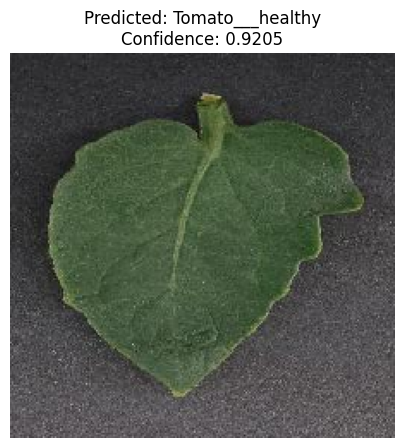

Image: TomatoHealthy2.JPG
Predicted Class: Tomato___healthy
Confidence: 0.9205
--------------------------------------------------
1/1 [==============================] - 0s 107ms/step


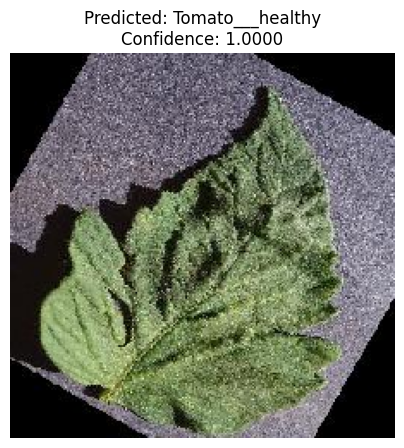

Image: TomatoHealthy3.JPG
Predicted Class: Tomato___healthy
Confidence: 1.0000
--------------------------------------------------
1/1 [==============================] - 0s 101ms/step


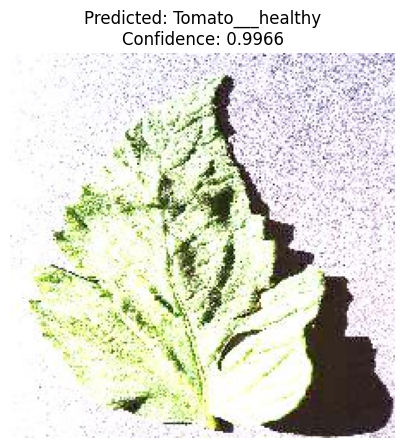

Image: TomatoHealthy4.JPG
Predicted Class: Tomato___healthy
Confidence: 0.9966
--------------------------------------------------
1/1 [==============================] - 0s 113ms/step


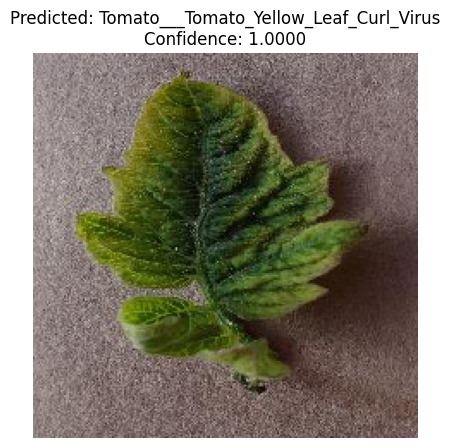

Image: TomatoYellowCurlVirus1.JPG
Predicted Class: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Confidence: 1.0000
--------------------------------------------------
1/1 [==============================] - 0s 107ms/step


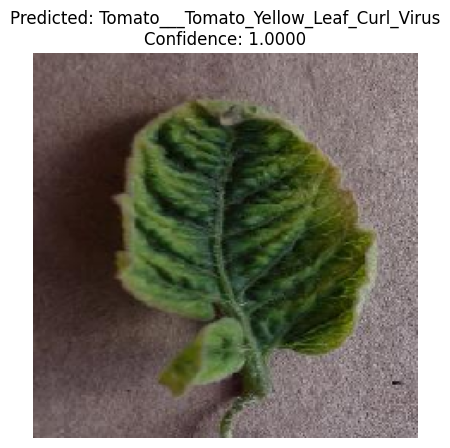

Image: TomatoYellowCurlVirus2.JPG
Predicted Class: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Confidence: 1.0000
--------------------------------------------------
1/1 [==============================] - 0s 110ms/step


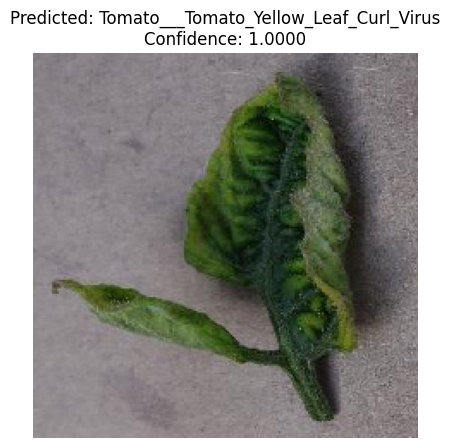

Image: TomatoYellowCurlVirus3.JPG
Predicted Class: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Confidence: 1.0000
--------------------------------------------------
1/1 [==============================] - 0s 116ms/step


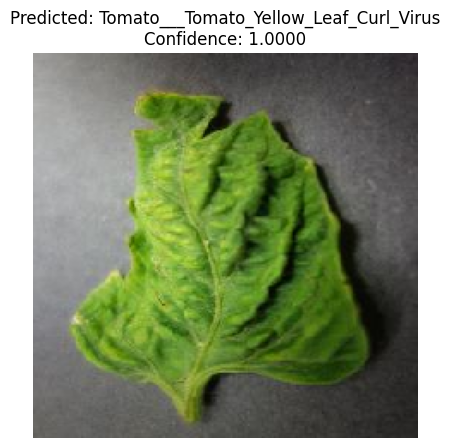

Image: TomatoYellowCurlVirus4.JPG
Predicted Class: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Confidence: 1.0000
--------------------------------------------------
1/1 [==============================] - 0s 112ms/step


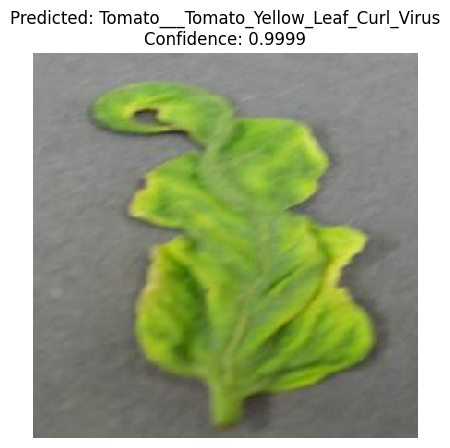

Image: TomatoYellowCurlVirus5.JPG
Predicted Class: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Confidence: 0.9999
--------------------------------------------------
1/1 [==============================] - 0s 119ms/step


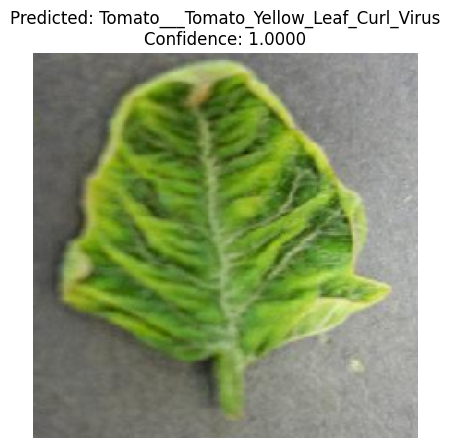

Image: TomatoYellowCurlVirus6.JPG
Predicted Class: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Confidence: 1.0000
--------------------------------------------------


In [124]:
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import matplotlib.pyplot as plt

# Load the trained model
model_path = 'final_model.h5'
model = tf.keras.models.load_model(model_path)

# Set the directory of test images
test_images_path = r'D:\New Plant Diseases Dataset(Augmented)\test'  # Directory where your test images are stored

# List all image files in the test directory
image_files = os.listdir(test_images_path)

# List of classes from your model (replace with your actual classes)
classes = [
    'Apple___Apple_scab', 'Apple___Black_rot', 'Apple___Cedar_apple_rust', 'Apple___healthy',
    'Blueberry___healthy', 'Cherry_(including_sour)___Powdery_mildew', 'Cherry_(including_sour)___healthy',
    'Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot', 'Corn_(maize)___Common_rust_',
    'Corn_(maize)___Northern_Leaf_Blight', 'Corn_(maize)___healthy', 'Grape___Black_rot',
    'Grape___Esca_(Black_Measles)', 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)', 'Grape___healthy',
    'Orange___Haunglongbing_(Citrus_greening)', 'Peach___Bacterial_spot', 'Peach___healthy',
    'Pepper,_bell___Bacterial_spot', 'Pepper,_bell___healthy', 'Potato___Early_blight', 'Potato___Late_blight',
    'Potato___healthy', 'Raspberry___healthy', 'Soybean___healthy', 'Squash___Powdery_mildew',
    'Strawberry___Leaf_scorch', 'Strawberry___healthy', 'Tomato___Bacterial_spot', 'Tomato___Early_blight',
    'Tomato___Late_blight', 'Tomato___Leaf_Mold', 'Tomato___Septoria_leaf_spot', 'Tomato___Spider_mites Two-spotted_spider_mite',
    'Tomato___Target_Spot', 'Tomato___Tomato_Yellow_Leaf_Curl_Virus', 'Tomato___Tomato_mosaic_virus', 'Tomato___healthy'
]

# Loop through each image in the test directory
for img_file in image_files:
    img_path = os.path.join(test_images_path, img_file)
    
    # Load the image and preprocess it
    img = load_img(img_path, target_size=(224, 224))
    img_array = img_to_array(img) / 255.0  # Normalize the image (if your model was trained this way)
    img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension
    
    # Predict the class
    predictions = model.predict(img_array)
    predicted_class_index = np.argmax(predictions, axis=1)
    predicted_class = classes[predicted_class_index[0]]
    confidence = predictions[0][predicted_class_index[0]]
    
    # Display the image along with the prediction result and confidence
    plt.figure(figsize=(5, 5))
    plt.imshow(img)
    plt.title(f"Predicted: {predicted_class}\nConfidence: {confidence:.4f}")
    plt.axis('off')  # Hide axes
    plt.show()
    
    # Print the result in the terminal as well
    print(f"Image: {img_file}")
    print(f"Predicted Class: {predicted_class}")
    print(f"Confidence: {confidence:.4f}")
    print('-' * 50)
